In [1]:
import pandas as pd
import numpy as np
from tqdm import tqdm
import mlcrate as mlc
import skimage
from skimage import io

In [2]:
import matplotlib.pyplot as plt

In [3]:
df_train = pd.read_csv('kaggle_train.csv')

#print(df_train['image_id'].tolist())


#selector = (df_train['image_id'] == 'brsk003-024')

selector = (df_train['image_id'] == '200021637-00016_1')

booklst = ["100241706_00005_2", "brsk001-005", 'brsk002-003', 'brsk003-024', '200003076_00157_1', 
           '200003076_00154_2', '200021637-00017_2', '200021660-00090_2', '200021712-00009_1', 
           '200021763-00032_2', '200021853-00021_2', 'brsk002-020']

for book in booklst:
    selector = selector | (df_train['image_id'] == book)

df_train = df_train[selector]

In [4]:
df_train.values

array([['100241706_00005_2',
        'U+306F 572 1376 125 57 U+306E 1551 2080 69 68 U+3078 891 1731 163 68 U+304C 309 1824 84 87 U+306B 292 1468 53 89 U+3081 901 1854 100 91 U+304B 1821 3067 168 96 U+3068 1888 2618 23 99 U+308A 324 2127 35 100 U+3084 865 2354 172 105 U+4E0A 257 1974 159 112 U+306B 877 2850 168 113 U+305F 905 2162 91 116 U+3088 609 3271 61 121 U+3044 1853 2747 105 132 U+3042 1189 2120 152 133 U+51E0 583 2062 148 135 U+3066 1209 2272 121 137 U+8A1B 1175 3006 192 139 U+59CB 1827 3365 163 140 U+3063 868 1996 168 140 U+4F55 555 2466 155 141 U+3080 1829 1179 160 141 U+5730 251 2867 200 141 U+3075 1845 2880 127 144 U+3089 1895 3165 81 145 U+5341 567 2674 124 145 U+6545 1503 2188 156 148 U+3084 1187 2656 161 148 U+308A 940 1359 37 155 U+4ED8 1535 2654 92 155 U+753A 1817 1860 159 155 U+306E 1841 2068 93 156 U+662F 607 3085 131 156 U+4F4F 1799 956 164 156 U+3084 1177 1675 180 156 U+3066 572 2258 99 157 U+3075 1817 2479 139 159 U+305F 884 1198 125 160 U+3089 940 2682 79 167 U+724

100241706_00005_2
[('U+306F', 634, 1404), ('U+306E', 1585, 2114), ('U+3078', 972, 1765), ('U+304C', 351, 1867), ('U+306B', 318, 1512), ('U+3081', 951, 1899), ('U+304B', 1905, 3115), ('U+3068', 1899, 2667), ('U+308A', 341, 2177), ('U+3084', 951, 2406), ('U+4E0A', 336, 2030), ('U+306B', 961, 2906), ('U+305F', 950, 2220), ('U+3088', 639, 3331), ('U+3044', 1905, 2813), ('U+3042', 1265, 2186), ('U+51E0', 657, 2129), ('U+3066', 1269, 2340), ('U+8A1B', 1271, 3075), ('U+59CB', 1908, 3435), ('U+3063', 952, 2066), ('U+4F55', 632, 2536), ('U+3080', 1909, 1249), ('U+5730', 351, 2937), ('U+3075', 1908, 2952), ('U+3089', 1935, 3237), ('U+5341', 629, 2746), ('U+6545', 1581, 2262), ('U+3084', 1267, 2730), ('U+308A', 958, 1436), ('U+4ED8', 1581, 2731), ('U+753A', 1896, 1937), ('U+306E', 1887, 2146), ('U+662F', 672, 3163), ('U+4F4F', 1881, 1034), ('U+3084', 1267, 1753), ('U+3066', 621, 2336), ('U+3075', 1886, 2558), ('U+305F', 946, 1278), ('U+3089', 979, 2765), ('U+7247', 1279, 3273), ('U+7406', 356, 31

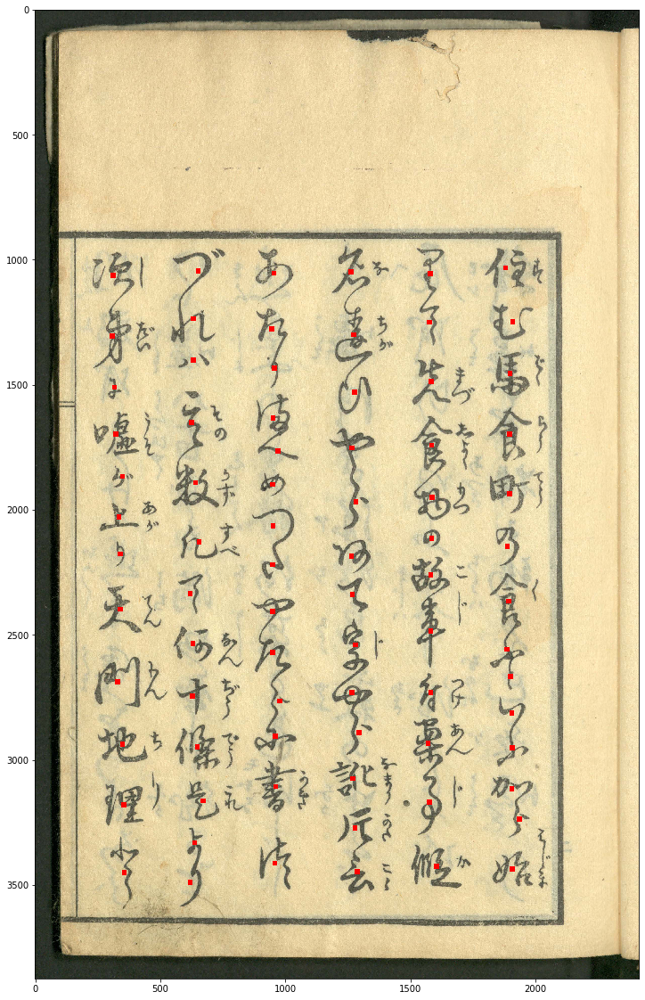

[310, 313, 318, 324, 330, 336, 341, 341, 351, 351, 356, 357, 621, 621, 626, 629, 632, 633, 634, 639, 642, 650, 653, 657, 672, 946, 950, 951, 951, 951, 952, 952, 956, 958, 959, 961, 962, 972, 979, 1263, 1265, 1267, 1267, 1269, 1271, 1274, 1278, 1279, 1281, 1283, 1287, 1295, 1571, 1576, 1577, 1579, 1581, 1581, 1582, 1584, 1585, 1585, 1587, 1604, 1881, 1886, 1887, 1892, 1896, 1897, 1898, 1899, 1905, 1905, 1908, 1908, 1909, 1935]


In [5]:
for img, labels in df_train.values:
    if type(labels) == float:
        continue
    chars = []
    for unic, x, y, w, h in np.array(labels.split()).reshape(-1, 5):
        chars.append((unic, int(int(x)+int(w)/2), int(int(y)+int(h)/2)))
    print(img)
    print(chars)
    img = io.imread('./data/train/train/{}.jpg'.format(img))
    
    for unic, x, y in chars:
        img[y-10:y+10, x-10:x+10, :] = [255, 0, 0]
    plt.figure(figsize=(20, 20))
    plt.imshow(img)
    plt.show()
    print(sorted([x[1] for x in chars]))
    break

13
               image_id                                             labels
2     100241706_00005_2  U+306F 572 1376 125 57 U+306E 1551 2080 69 68 ...
837   200003076_00154_2  U+306F 243 2207 52 34 U+306F 796 2104 73 37 U+...
842   200003076_00157_1  U+4E00 1086 1492 85 33 U+306F 611 2000 64 36 U...
1773  200021637-00016_1  U+4E00 411 2173 68 24 U+308B 332 316 36 31 U+3...
1776  200021637-00017_2  U+3078 399 1074 73 24 U+3078 440 2389 87 29 U+...
2031  200021660-00090_2  U+3078 1924 1757 80 24 U+30CF 1935 1840 56 29 ...
2052  200021712-00009_1  U+4E00 921 3190 64 11 U+4E00 935 2007 59 13 U+...
2261  200021763-00032_2  U+4E00 2523 2602 65 37 U+3005 697 3628 45 63 U...
2499  200021853-00021_2  U+3064 311 1646 55 40 U+3068 542 719 24 44 U+3...
2645        brsk001-005  U+306B 2137 3248 108 50 U+304B 1661 1345 39 52...
2679        brsk002-003  U+306F 656 870 71 31 U+306F 1356 1274 68 34 U+...
2696        brsk002-020  U+4E00 323 819 74 20 U+306F 1003 3479 48 27 U+...
2764        brsk003-02

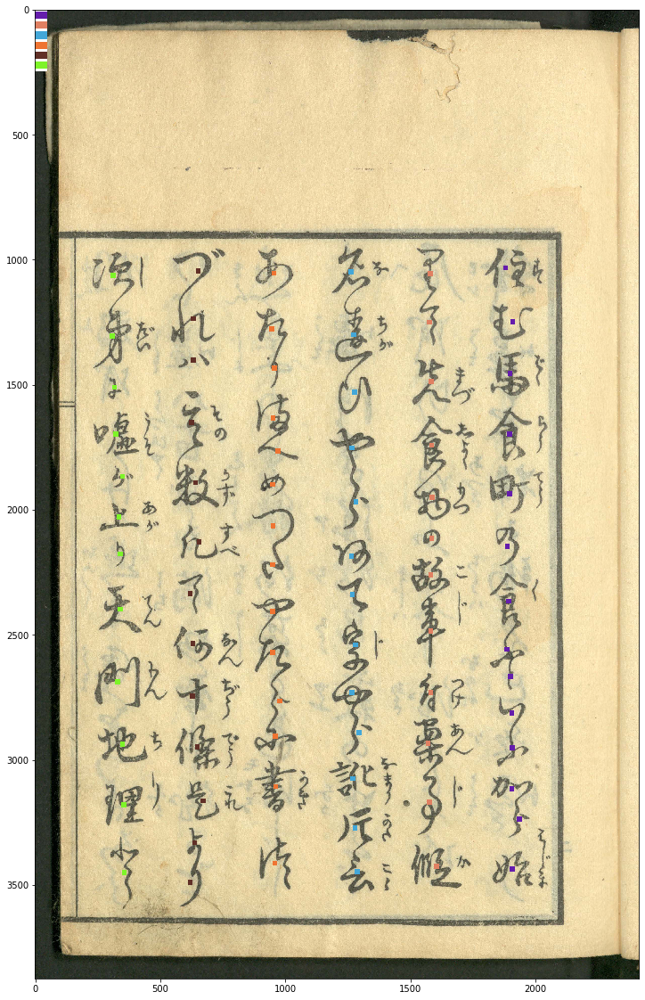

MEAN NEAREST NEIGHBOR DISTANCE 46.669986933685564
xlst shape (265, 2)
cl [ 0  1  2  3  4  5  6  7  3  8  7  5  0  5  3  6  5  9 10 11  9  1  6  9
  6  9  0 12  2  6  0  9  5  8  6  8  3  6  0  4  0  4 10  9  9 11  5 11
  1  3 11  5  1  6  7  5 11 12  0 12  5  0  1  0  6  3  6  7  9 11  8  0
  9  0  6  2  5  8  6 12  1 11  1  5  6  4  0  5 11  9  7 12  7  4  1  9
  1  1  6  9  7 11  3 13  7  7  0  0  5 12  6  8 10  7  0 12  8 12 11  0
 12  4  3  4  0  5  7  6  3  9 10 12  7  1  8  8 11  8  5  1  9  3  3 11
  0  9  9  1  7  4 11  9  2  7 11 12  0  0  3  6  5  4  1  8  9 12  1 12
 12  3  1  5 11 12  0  7 12  8  0  4  5  6  7  2  1  8  6  6  7  7  2  9
 12  5  9  9  6 11 10  5  7  1 12 12  4 11 12 12  8  8  1 13 11 11  2 13
  7 12  6  3  1  5  0  6  6  2  7  5 11  3 13  4  5  7  3  6 11  5  9  1
  4 12  0  7  8  1  9  7 10  6  9  3 11  1 13  0 10 11 10  2  3  9  4  5
 14]
clusters [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14]
taking by rightmost logic 5
taking by rightmost logic 9
tak

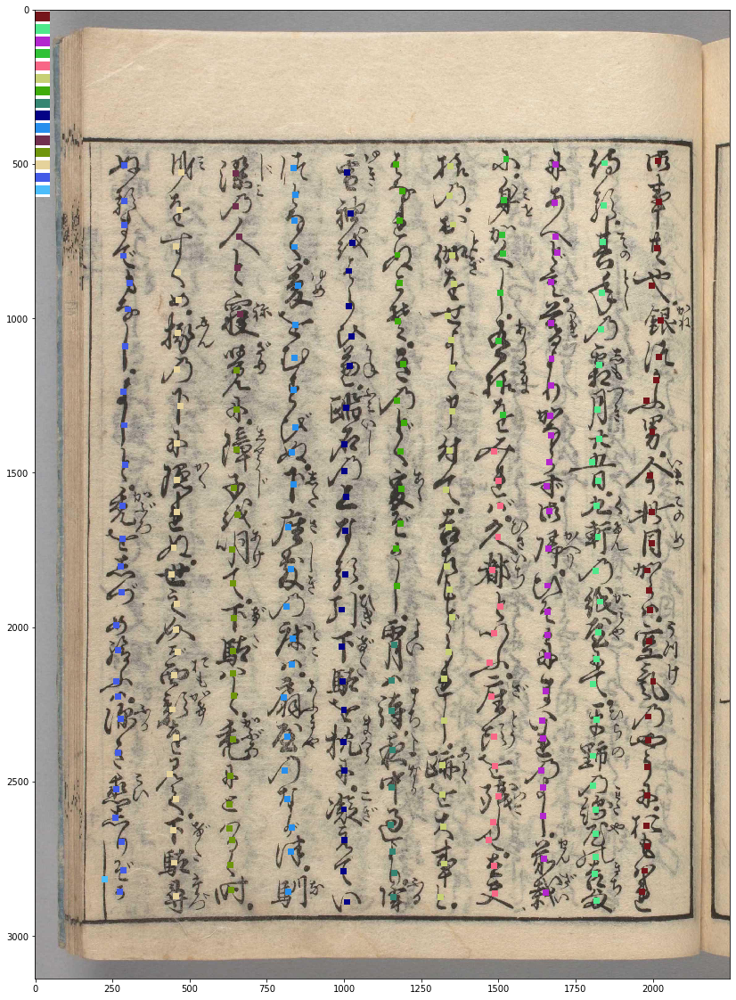

MEAN NEAREST NEIGHBOR DISTANCE 45.667856724627924
xlst shape (265, 2)
cl [ 0  1  2  3  4  2  2  5  0  3  3  5  4  6  0  3  2  7  5  2  4  8  7  9
  0  1  5  5  7  7 10  7 11  6  3  5  2  1  5  1  6  3  0  7  0  9 10  6
  4  6  1  0  3  2  4  8  9  5 10  8  6  6  9  5  0  3  2  7  2  6  0 12
  9  5  4 10  6  2  1  6 10  5  5  6  3  1  7  6  1  2 10  7 10  1  9  2
  1  4  3  4  3  3  6  4  1  5  2  8  6  5  5  2  3  4  8  1  0  9  9  1
  6 10  2  6  2 10 10 10  8  9  0 10  8  4  0  0 10  4  9  7  0  4  7  1
  9  7  5  4  9  3  9  3  7  8 10  5  1 10  5  1  8  0  9  4  3  2  5  0
  9  5  2  8  3  6  8  3  9  3  0  9  4  8  6  8  8  4  6  3  7  8  3  7
  7  8  8  6  4  3  4  7  2  4  5  2 10  2 10  7  8  7  9  1  1 10  9  8
  1 10  7  2  0  3 10  1  9  8  4  5  8  4  3  5  8  1  2  0  0  5  9  6
 10  2  7  4  2  6  3  6  6  0  9  4  7  9 10  7  5  2  5 10  0  0  1 13
  1]
clusters [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13]
taking by rightmost logic 4
taking by rightmost logic 3
taking 

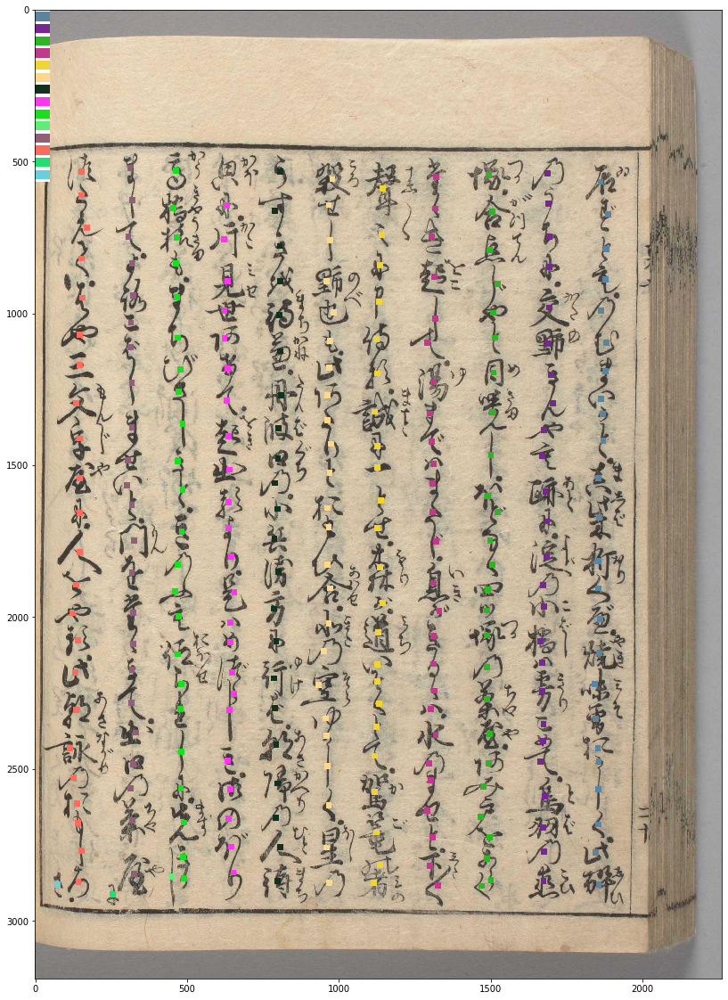

MEAN NEAREST NEIGHBOR DISTANCE 46.37882862348247
xlst shape (134, 2)
cl [ 0  1  2  3  4  2  5  6  7  8  7  9  7 10 11 12 12  8 13  5  9 11 14  8
  2 15 16 17 18 19 20 16 10 21  4 22 23 24 17 20 25  1  7  4  7  3 24 19
 26 27  3 28 29 15 28 30 13 31  9 32  2 25 20 33 18  2 28 33 34 35 24 15
  0 22  3 36  3 13 37 30 27 32 24  0 38 26 29  4 24 34 39 18 22 40 17 41
 22 42  6 14 43  6 40 38 44 22 36 33  4  2 45  6 11  6 16 42 12 43 46 12
 28 35 41 14 44 39 12 41 35  9 31 47 12  6]
clusters [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47]
taking by rightmost logic 22
taking by rightmost logic 12
taking by rightmost logic 34
taking by rightmost logic 42
taking by rightmost logic 29
taking by rightmost logic 23
taking by rightmost logic 27
taking by rightmost logic 13
taking by rightmost logic 38
taking by rightmost logic 41
Taking new cluster by neighbors! 9
ta

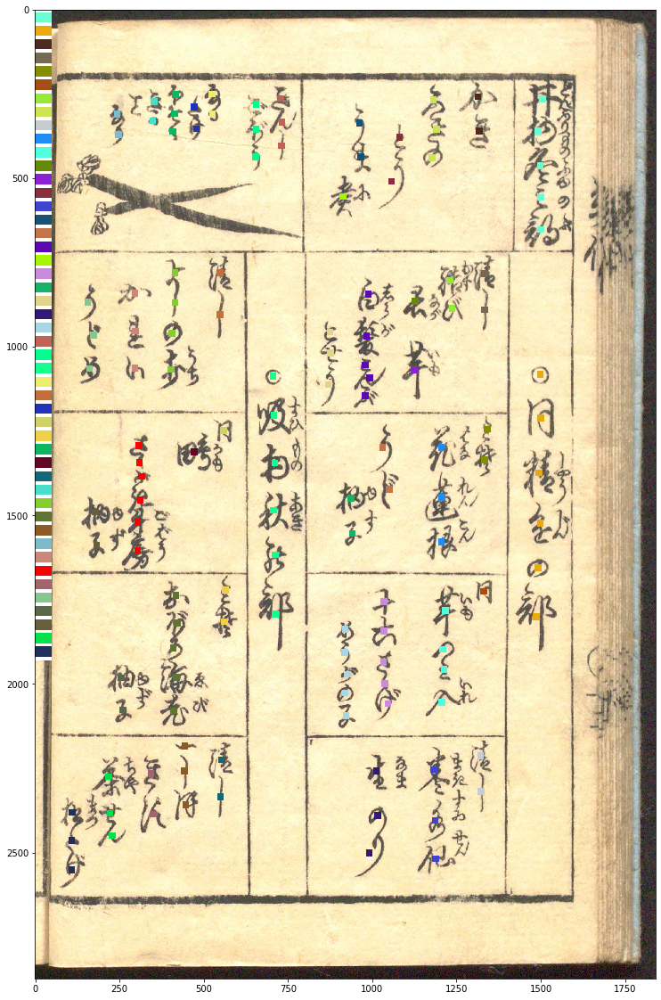

MEAN NEAREST NEIGHBOR DISTANCE 38.525022257650065
xlst shape (213, 2)
cl [ 0  1  2  3  4  5  6  7  8  9 10  6 11 12  8  6 13 14  3 15 11 13 13 16
  8 13 17 18 19 11  2 17 20 21 11 22 16 14 20  5 17  6 23 24  3  9  3 12
  6 25  7  2 26 16 25 27  9 28  6  8 25 29 21 30 26 11 23  6 31 32 33  6
  6 10 13 34 16 35 35  6 36 20 37 35 37 38 32  7 15 39 36 26 40 18 41 42
  6 36 27 25 39 24 20 35 40 43 33 19 44 45 46 47 38  6 48 10  4 10 49 36
  0 26 29 42 24 50 10  5 34 43 38 51 52  8  4 43 28 15 39  6 53 27 26 54
 27 25 55  4  5 45 35 40  0 36 27 56 18 41  4 33 54 52 25 49 37 44 39 33
 55 28  1 34 55 19 30 35 54 57  8 18 21 58 18 59 21 47 53 22 41 33 60 30
 32 59 21 41 48 60 56 54 53 21 48 61 30 61 52 22 62 63 29 64 30]
clusters [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64]
taking by rightmos

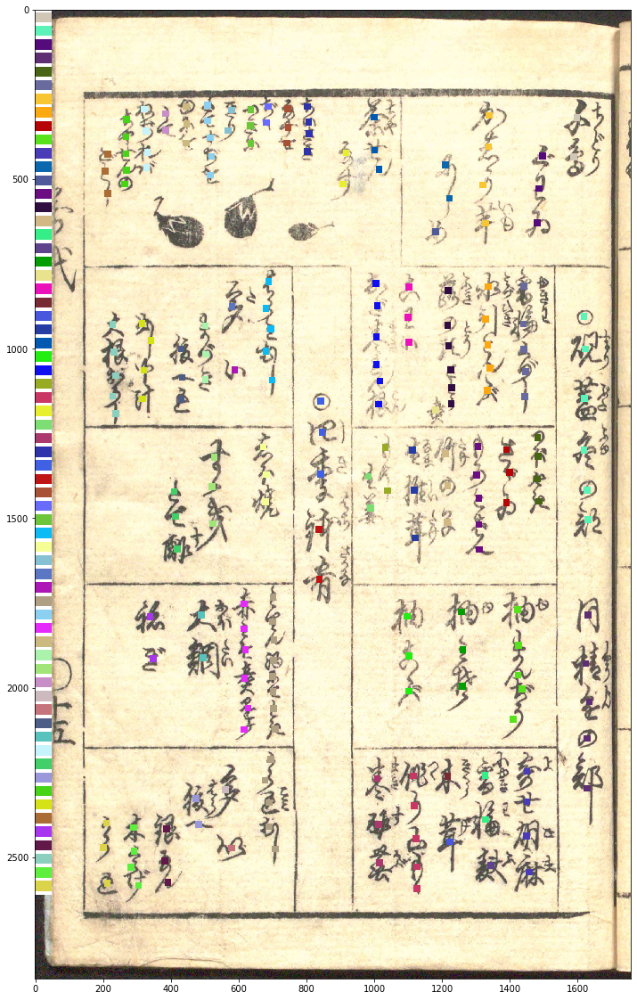

MEAN NEAREST NEIGHBOR DISTANCE 32.74116697353878
xlst shape (107, 2)
cl [ 0  0  0  1  2  3  4  3  5  6  4  1  7  8  9  3  7 10  2  2  0  6 11 12
  1  5  1  1  6  2  2  2  0  5  3  9  7 12 13  7  4  2 14  7  1  4  8 15
 14  4  9  4  1  6  0  5 12  5  7  2  5  7  7  5  3 16 12  1 15  7  9  2
 15  6 12  3  5  2  2  6  0  8  5 10  0  5  3 17  5  6 12 12 14 17  3 14
  9 13  6  8  0 11  1  2  7  8 10]
clusters [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17]
taking by rightmost logic 2
taking by rightmost logic 5
taking by rightmost logic 7
taking by rightmost logic 1
taking by rightmost logic 0
taking by rightmost logic 3
taking by rightmost logic 6
taking by rightmost logic 13
Taking new cluster by neighbors! 16
taking by rightmost logic 11
taking by rightmost logic 17
Taking new cluster by neighbors! 9
taking by rightmost logic 12
taking by rightmost logic 8
taking by rightmost logic 4
taking by rightmost logic 14
taking by rightmost logic 15
taking by rightmost logic 10
new

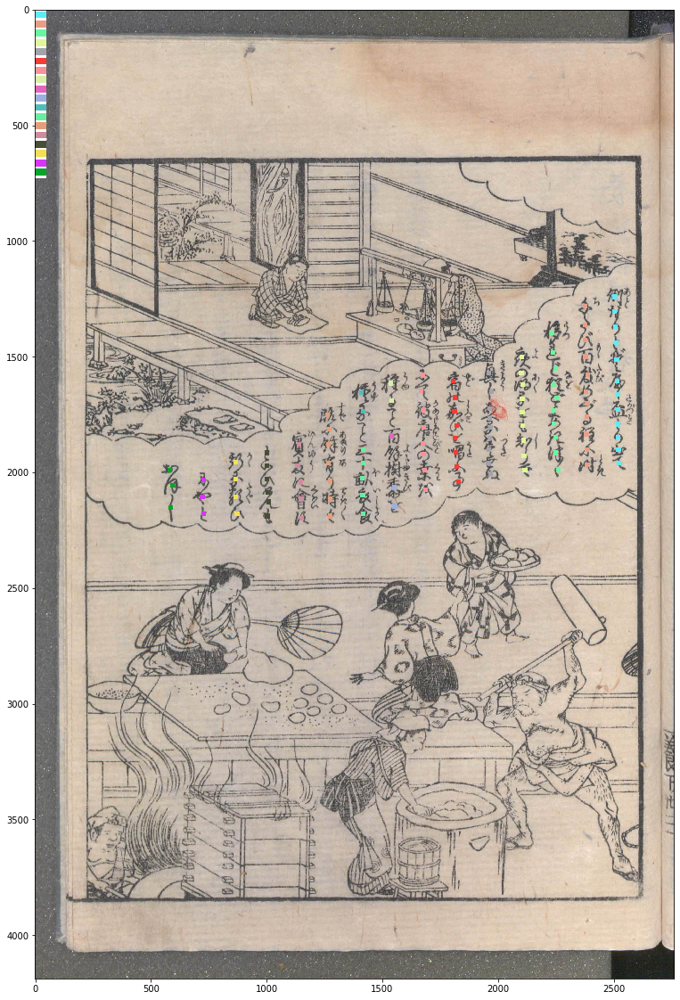

MEAN NEAREST NEIGHBOR DISTANCE 54.869170275434
xlst shape (123, 2)
cl [ 0  1  2  3  4  5  4  6  7  6  1  8  9 10  3  2 10 11 11  5  3 12  9 13
  2 14 13 15 10  0  8 16  2  7  5  5 15 17 10  2 18 15 19  6  8 20 21 17
 22  5 19 14 23 12 22  4 19 24 25  2 16 12  2 21 16  5 10  1  2 10 20 15
 15 16 23  8 26 10 23 12 15 17  5  2 19 23 25 24  2 24  8 24  8 22 21 23
 16 18 17 18  8 18 24 17 25 16 18 20 24 21 19  0  5 17 16 10  5 24 25  5
 12 25 10]
clusters [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26]
taking by rightmost logic 10
Taking new cluster by neighbors! 16
taking by rightmost logic 9
taking by rightmost logic 17
taking by rightmost logic 7
Taking new cluster by neighbors! 26
taking by rightmost logic 8
taking by rightmost logic 24
Taking new cluster by neighbors! 11
taking by rightmost logic 21
taking by rightmost logic 13
taking by rightmost logic 25
taking by rightmost logic 14
Taking new cluster by neighbors! 2
taking by rightm

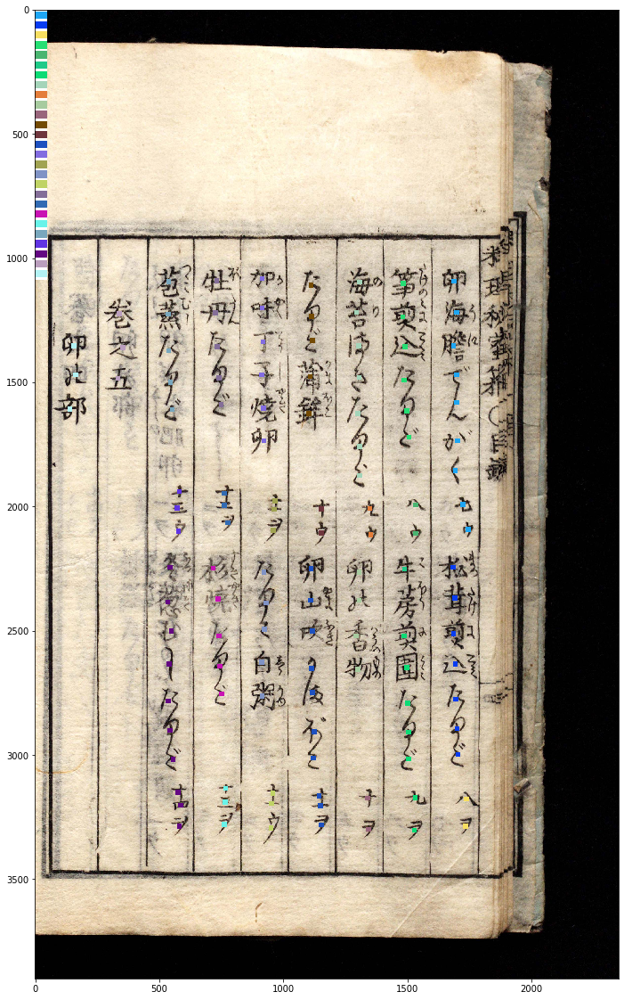

MEAN NEAREST NEIGHBOR DISTANCE 68.28466175211092
xlst shape (213, 2)
cl [ 0  1  2  3  4  5  6  7  8  8  9 10 11 12 13 14 15 16 17 11  7  9 18  4
 19 20 21 21 18  9 22  6 12 23  5 12 24  6 15  9 21 22  1 25 26 20  4 26
 27  2 28  7 12  2  3 24  9  1 20 21 16 13 26  5 13 29  1 21 14 19 29  0
  1 19 15  6  1 10 15 30 10 11  1 31 13 26 18  1  8 16  8  0 21 11 24 26
 32 11  0 14 33  2 11 28  9 28 18 18 19 27  2 34 19  0 35 31  0 36 14 32
  3 24 20  8 12 31  7  1 37 14 12 25 33  4 28 13 22 12 31 10 35 23  1 35
  3 34 34  1 27  6 38 39  1 35  0 22 40 41 37 30 22 12  1  1  7  5 42 43
  0  1  5  1 37 22  8 12  0 10 12 22 34 22 33 12  0 29  1 44 44 22 22 37
  1 29 30 23  1 12 45 43  1 36  1 12 27 12  0 22 22 46  0 37 17]
clusters [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46]
taking by rightmost logic 0
taking by rightmost logic 35
taking by rightmost logic 8
taking

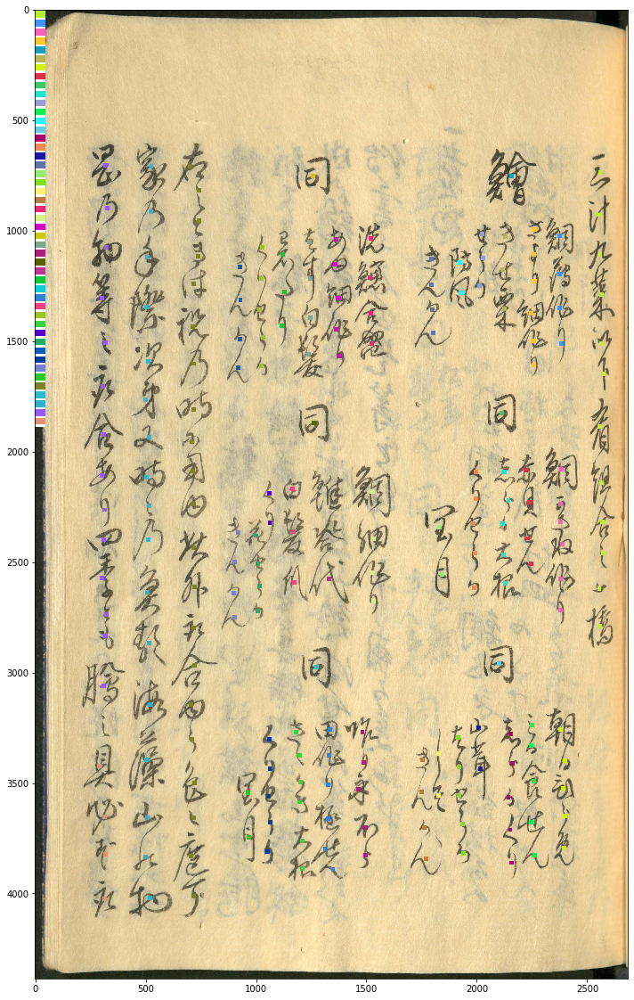

MEAN NEAREST NEIGHBOR DISTANCE 40.951453098444304
xlst shape (134, 2)
cl [ 0  1  2  3  2  4  5  6  7  8  9  0 10  6  2 11  7 12 13  3 14 15 16 17
 18 12  3  1 13 19 10  7  1  4  5 11 20 13 11 11 21 13 20 22 16 23 24  9
 25  7  8 20  8 26 20 19 27 28  4 29  5 30 27 31  1 32 11 31 12 28 33 11
  9 34 17 17 35 18 36 37 22 19 13 14 35 27 20  8 33 28  3 30 21 12 15  9
 38 19 39 16 39 40  5 37 40  7 32 22 27  4 26 36 41  1 29 16 11 30 37  5
 25 38 42 43 40 38 15 34 25 18 44 42 21 18]
clusters [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44]
taking by rightmost logic 4
taking by rightmost logic 30
Taking new cluster by neighbors! 44
taking by rightmost logic 40
taking by rightmost logic 11
taking by rightmost logic 38
taking by rightmost logic 18
taking by rightmost logic 41
taking by rightmost logic 28
taking by rightmost logic 16
taking by rightmost logic 9
taking by righ

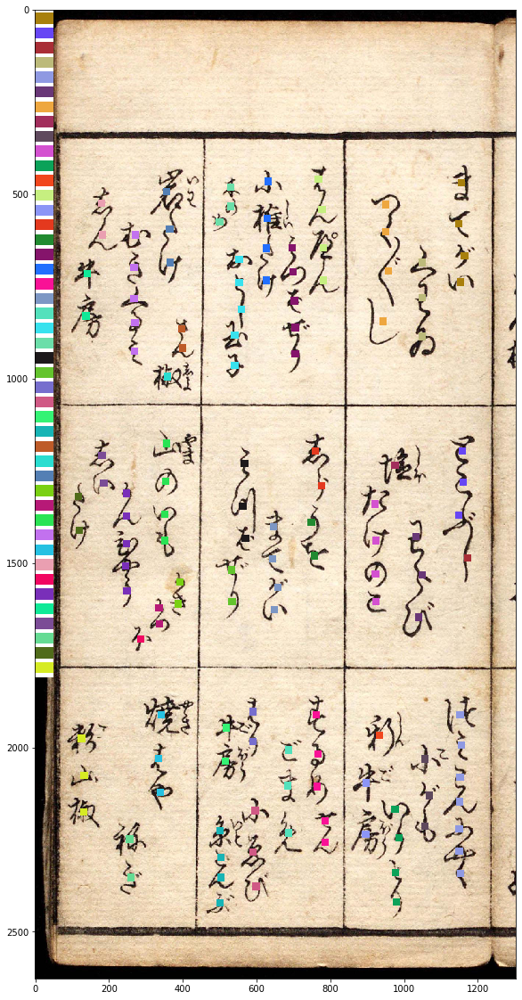

MEAN NEAREST NEIGHBOR DISTANCE 58.1851838747052
xlst shape (165, 2)
cl [0 1 2 2 2 0 3 4 1 1 2 3 5 1 6 3 0 7 2 7 2 5 2 5 6 2 3 5 3 5 0 6 1 2 7 0 1
 3 0 1 3 5 5 2 1 3 3 4 4 2 5 4 2 0 7 3 7 6 7 3 2 5 5 1 5 7 2 2 1 4 7 1 2 1
 7 6 6 1 6 2 3 7 6 0 0 1 7 5 1 3 2 1 6 7 4 4 0 0 6 5 7 0 1 4 5 1 7 6 2 3 1
 5 1 7 6 0 5 4 0 3 7 6 6 2 0 0 2 7 3 0 0 3 1 4 7 3 7 5 5 6 3 3 3 2 6 2 6 7
 3 6 5 5 6 3 0 0 1 0 7 1 2 5 7 6 4]
clusters [0, 1, 2, 3, 4, 5, 6, 7]
taking by rightmost logic 0
taking by rightmost logic 2
taking by rightmost logic 1
taking by rightmost logic 3
taking by rightmost logic 6
taking by rightmost logic 7
taking by rightmost logic 5
taking by rightmost logic 4
new clusters [0, 2, 1, 3, 6, 7, 5, 4]


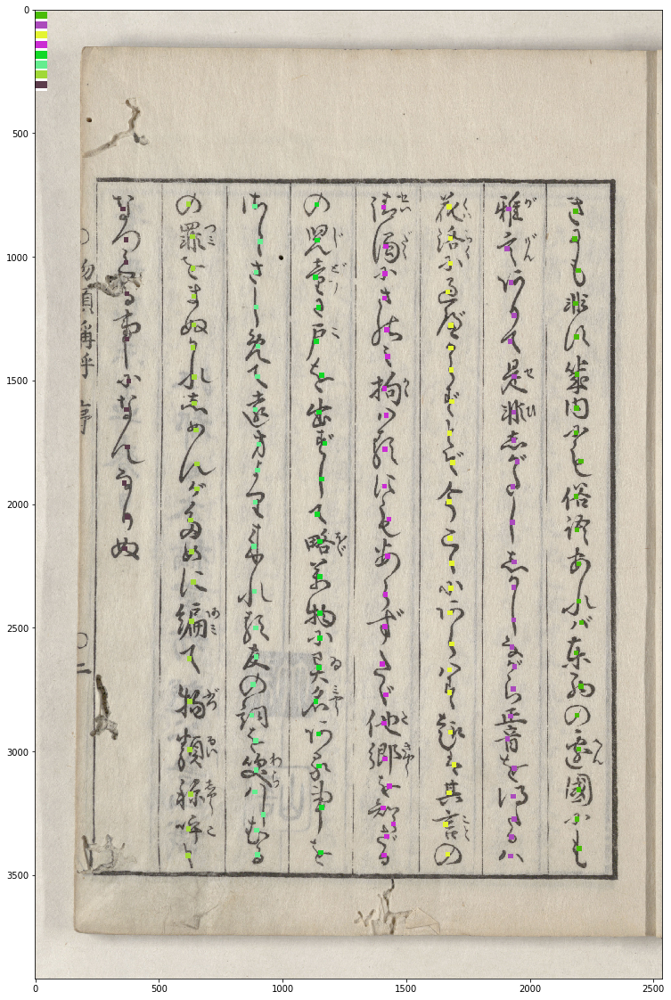

MEAN NEAREST NEIGHBOR DISTANCE 47.197529051976986
xlst shape (257, 2)
cl [ 0  1  2  3  4  4  5  5  1  5  2  0  1  1  2  2  6  7  3  2  8  2  1  7
  2  2  8  6  9  0  3  1  0  1  7  5  4  5  2  2  6  8  6  6  0  5  6  5
  5  5  4  3  0  3  5  1  7  7  4  8  2  6  8  0  4  2  3  1  5  4  7  0
  0  0  6  7  0  6  6  2  6  5  5  3  5  0  6  0  1  0  6  2  1  4  1  1
  1  2  6  2  2  8  2  5  4  1  1  0  7  8  5  7  7  9  8  2  2  3  8  4
  3  0  8  5  2  4  5  4  0  5  4  4  6  2  8  2  0  3  6  2  5  1  1  1
  6  2  3  7  6  0  0  4  2  8  0  3  0  6  7  6  6  6  0  8 10  4  6  2
  1  1  4  1  0  7 10  5  1  5  1  4  7  0  4  8  4  2  3  0  5  5  5  8
  7  3  7  7  4  6  5  6  4  3  0  9  4  1  8  1  4  2  6  3  5  7  8  8
  2  7  8  8  4  7  6  4  5  8  7  1  3  8  5 11  0  4  7  7  7  8  1  6
  9  8  1  6  8  9  9  3  0  3  8  9 11  4  3  3 10]
clusters [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11]
taking by rightmost logic 9
taking by rightmost logic 11
taking by rightmost logic 4
taking by r

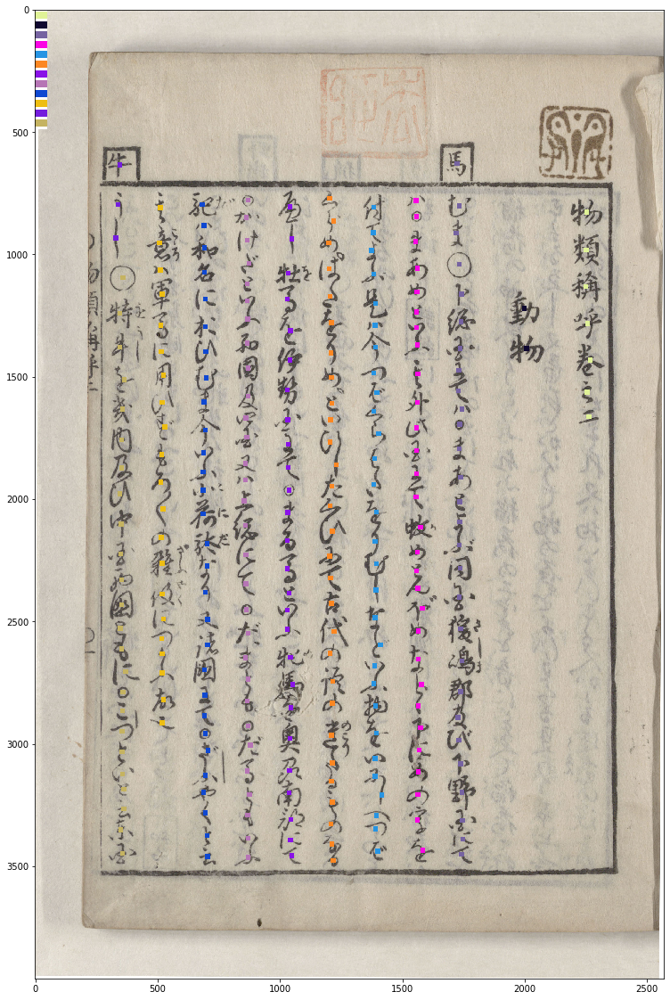

MEAN NEAREST NEIGHBOR DISTANCE 39.86660764621067
xlst shape (416, 2)
cl [ 0  1  2  3  2  2  4  5  2  6  7  2  8  2  2  9  9 10 11  6 12  4  4  9
 11 13 14 11 15  3 16 17  0 18  7  2 16 19  4 13  2 20 21  1 10  0 10  6
  6  7 22 18 19 20  2 17 20 17 10 16  4  4  9  6 23 13  7  8 17  5 15 10
 20 12  8  3  8 22 23 21 22 11 17  7  9  0 21 12  6 11 19 17  6 16 15  7
  0 19  6  5  6 22  0 19  7  7  2  8 22  8 24 13 21 17 19 12  8 13  6 15
  0  7  9 24 11  8 13 24 19 21 21  8 13  6  5 16 10  1 22 20 21 18 12 21
  0 19  5  6 16 24 16  9  2 10 18  8  4 13  6  2 19 19 13  8 21 25 17 15
  6 21 25 25 17 17  0 17 24 10  8  9  0 13 13 13 11 21 15 13 16  5 17  2
 13  6 19  4  8 14 16 25  8 13  3  2  5  9 16  4  5 23 13 10  2  8  0 19
 16 21  0  7  7  6 23  4  2 19 24 24 11 19 21 24 12 22 21  8 13  8 13  6
  5 22 22  9 21  4  8 21 19 13  6 25  8 18  8 20 24 26 18 20 20 20  3  5
 24 19 13  4 13 19 13  0 16 22 21 21 25 10  6 19 27 22  5 23 21  6 21 20
 22 13  8 18 18  6  6  0 21 22 20  9 24  8  5 18 10 

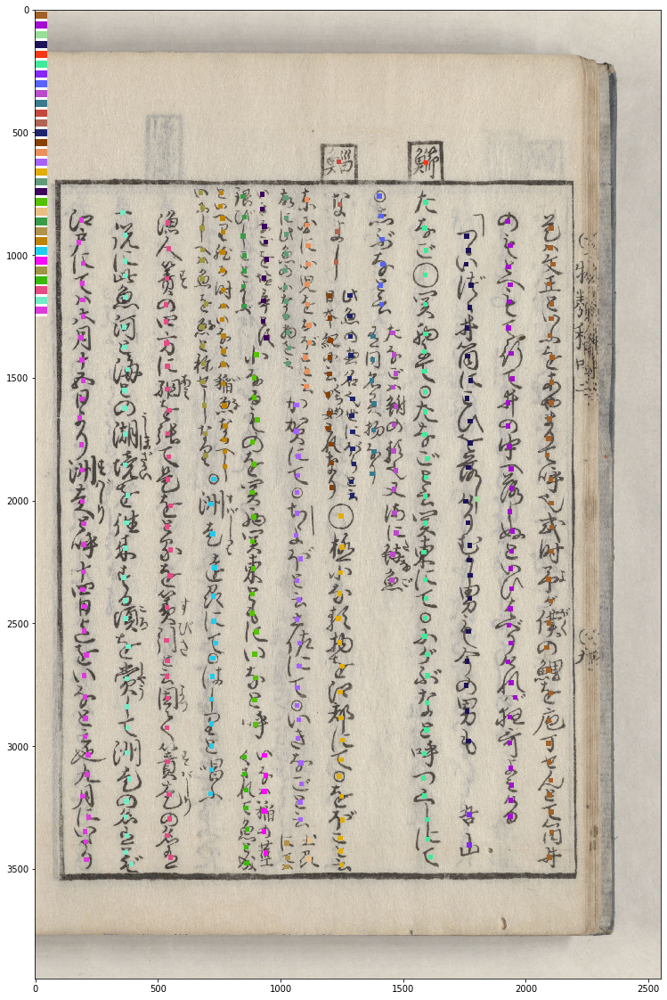

MEAN NEAREST NEIGHBOR DISTANCE 40.81666403081933
xlst shape (316, 2)
cl [ 0  1  2  3  3  4  5  0  6  3  7  6  8  9  5 10 11 10 12  8 13 10 14 14
 14  6  3  5 15  3  9  8  3 11 16 14  1 14  8 17 13  3  3 14  5 13 11  1
 16 17 12 17 11  7  3  5  8  8  5  3  3  8  0 11  1  3  8 12 13  3 15 13
  3  0  3  3  9  0  9 14 12  6 14 17  6  3 13  5 16 16 14 15 17  6 18 13
  9  3  7 12  0 12 16  4 13  3  4 11 13 13 14  0 11  6  9 15 13  3  2 11
  2 16  4 10  6 13  0 11  0 14 14 13  6  0  1 11  6  9  9 11  4  1 14  9
  3  4  3 11 19 14 10  1 14  8 13  0 13 12  9 16  3  6  1 13 10 14  1 13
  9  4  0 10 12  0  0  9 12 16 10 14  6 14  9 15  3  0  1  2 11  6  3 16
 12 14 11 10  3  9 13 12  9  3  7  6 11 12 14 19 11 15  4 14 13 13  7  1
 10  6  9 13  6 14 17  0 16 12 14  1  9 17  2 14  0 14 16  2 14  1 19 12
  0 13  3  9 13  1  3  1 18  1  9  6  0  3  7 14 12 11  9  6  0 14  1  3
 16  1 16  2 13  4  9 14  4  1 19  0 11  8  6 14  0  3  1 11 16  6 16 11
  3  0  9  9 14  3  9  1  0  2 11 11  3  0 19  1  2 

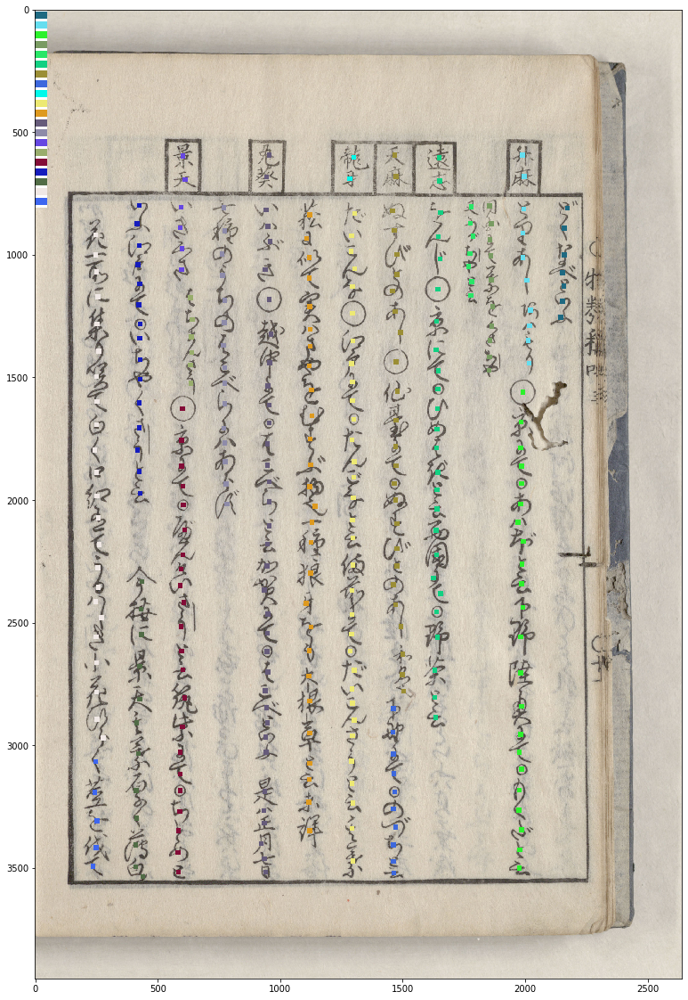

In [6]:

#Cell for performing clustering.  
#Steps: do a DBSCAN clustering, then save the image with cluster centers overlaid.  

'''What about doing a hierarchical clustering and then reading 
by iterating over cluster centers.  '''

from sklearn.cluster import DBSCAN
import sklearn
import pandas as pd
import random

#print('running')

#print(sorted(sklearn.neighbors.VALID_METRICS['brute']) )


print(len(df_train.values))

print(df_train)


for img, labels in df_train.values:
    

    xlst = []
    
    if type(labels) == float:
        continue
    chars = []
    for unic, x, y, w, h in np.array(labels.split()).reshape(-1, 5):
        chars.append((unic, int(int(x)+int(w)/2), int(int(y)+int(h)/2)))
    #print(img)
    #print(chars)
    img = io.imread('./data/train/train/{}.jpg'.format(img))
    
    for unic, x, y in chars:
        img[y-10:y+10, x-10:x+10, :] = [255, 0, 0]
        xlst.append([x,y])
        
    xlst = np.array(xlst).astype('float32')
    
    from sklearn.neighbors import NearestNeighbors
    nbrs = NearestNeighbors(n_neighbors=2, algorithm='ball_tree').fit(xlst)
    
    distances, indices = nbrs.kneighbors(xlst)
    
    mean_dist = np.mean(distances)
    print("MEAN NEAREST NEIGHBOR DISTANCE", np.mean(distances))
    
    clustering = DBSCAN(eps= mean_dist * 4.0, min_samples=1)

    
    #xlst[:,0] *= 0.1
    
    xlst_cluster = xlst * 1.0
    
    xlst_cluster[:,0] *= 5.0
    
    print('xlst shape', xlst.shape)
    
    #print('xlst', xlst)
    
    cluster_labels = clustering.fit_predict(xlst_cluster)
        
        
    #pd.Series(cluster_labels).value_counts()
    
    print('cl', cluster_labels)
    
    cluster2chars = {}
    
    for j in range(0, len(cluster_labels)):
        #print('cluster', cluster_labels[j])
        #print('char', xlst[j])
        
        if not cluster_labels[j] in cluster2chars: 
            cluster2chars[cluster_labels[j]] = []

        cluster2chars[cluster_labels[j]].append(xlst[j])
            
    cluster2color = {}
            
    for keyc in cluster2chars: 
        #print(keyc)
        randcolor = [random.randint(0,255), random.randint(0,255), random.randint(0,255)]
        #print(cluster2chars[keyc])
        cluster2color[keyc] = randcolor
        for chararray in cluster2chars[keyc]:
            x = int(chararray[0])
            y = int(chararray[1])
            img[y-10:y+10, x-10:x+10, :] = randcolor
        
        
        
    clusters = list(cluster2chars.keys())
    
    print('clusters', clusters)
    #Reorder the clusters!
    #Steps: 
    #Check for neighbor below bottom.  If it's close add it.  
    #Check for neighbor near tops.  If it's close add it.  
    #Otherwise take the right-most column.  
    
    new_clusters = []

    while True:
        
        #Break if all clusters are assigned.  
        if len(clusters) == 0:
            break

        
        #Below-logic
        
        if len(new_clusters) > 0:
            last_chars = np.array(cluster2chars[new_clusters[-1]])
            
            last_bottom_y = last_chars[:,1].max()
            last_bottom_x = last_chars[:,0].mean()
            
            smallest_dist = float('inf')
            closest = -1
            
            for cluster in clusters:
                chars = np.array(cluster2chars[cluster])
                
                bottom_y = chars[:,1].min()
                bottom_x = chars[:,0].mean()
                
                dist = abs(last_bottom_y - bottom_y) + 5.0 * abs(last_bottom_x - bottom_x)
                
                if dist < smallest_dist and bottom_y > last_bottom_y:
                    smallest_dist = dist
                    closest = cluster
                    
            #print('smallest_dist', smallest_dist, 'threshold', mean_dist*7.0)
            if smallest_dist < mean_dist * 7.0: 
                clusters.remove(closest)
                new_clusters.append(closest)
                print('Taking new cluster by neighbors!', closest)
        
        if len(clusters) == 0:
            break
        
        #Right-most logic.  
        
        rightmost = -float('inf')
        pick = -1
        for cluster in clusters:
            chars = np.array(cluster2chars[cluster])
            hor_center = chars[:,0].mean() - 0.1 * chars[:,1].mean()
            if hor_center > rightmost: 
                pick = cluster
                rightmost = hor_center
                
        print('taking by rightmost logic', pick)
        clusters.remove(pick)
        new_clusters.append(pick)
    
        
            
    clusters = new_clusters
    
    print('new clusters', clusters)
    
    img[0 : 40*(len(clusters)) + 10, 0:50, :] = 255
    for j in range(len(clusters)):
        img[(j)*40 + 10 : (j)*40 + 40, 0 : 50, :] = cluster2color[clusters[j]]
            
    plt.figure(figsize=(20, 20))
    plt.imshow(img)
    plt.show()
    #print(sorted([x[1] for x in chars]))
    #break
